In [1]:
%load_ext autoreload
%autoreload 2

In [2]:
import numpy as np
import vmo.analysis as van
import vmo.generate as vge
import matplotlib.pyplot as plt
import librosa, pickle, vmo
import sklearn.preprocessing as pre
import IPython.display 

%matplotlib inline

In [3]:
target_file = '../files/tenor_sax.wav'

fft_size = 8192 * 4
hop_size = fft_size/2

In [4]:
y, sr = librosa.load(target_file, sr = 44100)
C = librosa.feature.chromagram(y=y, sr=sr, n_fft=fft_size, hop_length=hop_size, octwidth = None)
feature = np.log(C+np.finfo(float).eps)
feature = pre.normalize(feature)
# feature = pre.normalize(C)

In [5]:
IPython.display.Audio(data=y, rate=sr)

## Improvisation without Switching

In [6]:
chroma_frames = feature.transpose()
r = (0.0, 0.25, 0.001) 
ideal_t = vmo.find_threshold(chroma_frames, r = r,flag = 'a',VERBOSE = False)

oracle_t = vmo.create_oracle(flag = 'a', threshold = ideal_t[0][1])
seq = []
state = 0
LRS = 1
for i,chroma in enumerate(chroma_frames):
    oracle_t.add_state(chroma)
    if i >= 50:
        if continuity_count_down != 0:
            seq.append(state)
            if state+1 < oracle_t.n_states-1:
                state += 1
                continuity_count_down -= 1
            else:
                state = seq[-1]
                continuity_count_down = 0
        else:
            seq.append(vge.improvise_step(oracle_t, state, LRS = LRS, weight = 'lrs'))
            state = seq[-1]
            if state+1 < oracle_t.n_states-1:
                state += 1
            else:
                state = 1
            continuity_count_down = np.floor(oracle_t.avg_lrs[-1])
    else:
        continuity_count_down = np.floor(oracle_t.avg_lrs[-1])
        

[0, 1, 2, 3, 5, 6, 7, 8, 9, 3, 4, 5, 6, 7, 10, 11, 12, 13, 14, 8, 9, 10, 11, 12, 3, 4, 5, 6, 7, 8, 17, 18, 19, 20, 21, 22, 15, 16, 17, 18, 19, 20, 24, 25, 26, 27, 28, 57, 58, 59, 60, 61, 59, 60, 61, 62, 63, 92, 93, 94, 95, 96, 98, 99, 100, 101, 102, 96, 97, 98, 99, 100, 104, 105, 106, 107, 108, 72, 73, 74, 75, 76, 29, 30, 31, 32, 33, 78, 79, 80, 81, 82, 40, 41, 42, 43, 44, 46, 47, 48, 49, 50, 87, 88, 89, 90, 91, 24, 25, 26, 27, 28, 121, 122, 123, 124, 125, 153, 154, 155, 156, 157, 159, 160, 161]


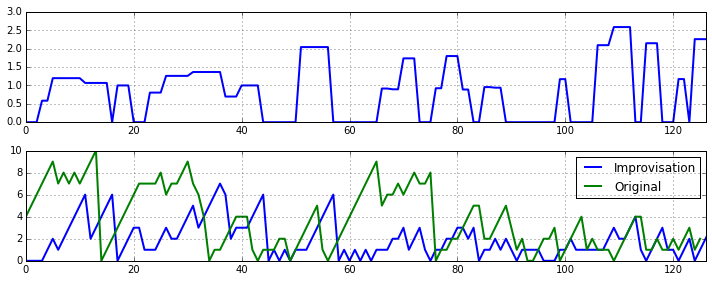

In [7]:
print seq
x, _w = vge.audio_synthesis(target_file, 'vmo_synthesis_test.wav', seq, 
                            buffer_size = fft_size, hop = hop_size)
C_x = librosa.feature.chromagram(y=x, sr=sr, n_fft=fft_size, hop_length=hop_size, octwidth = None)
feature_x = np.log(C_x+np.finfo(float).eps)
feature_x = pre.normalize(feature_x)
chroma_frames_x = feature_x.transpose()
oracle_x = vmo.build_oracle(chroma_frames_x, flag = 'a', 
                            threshold = ideal_t[0][1], 
                            feature = 'chroma')

plt.figure(figsize = (10,4))
ir_x, h0, h1 = oracle_x.IR()
plt.subplot(2,1,1)
plt.plot(ir_x, linewidth = 2)
plt.grid('on')
plt.xlim(0, oracle_x.n_states-2)
plt.subplot(2,1,2)
plt.plot(oracle_x.lrs, linewidth = 2)
plt.hold('on')
plt.plot(oracle_t.lrs[50:], linewidth = 2)
plt.grid('on')
plt.xlim(0, oracle_x.n_states-2)
plt.legend(['Improvisation','Original'])
plt.tight_layout()

In [8]:
IPython.display.Audio(data=x, rate=sr)

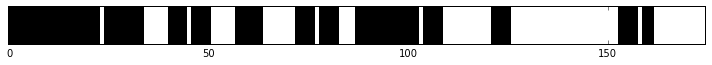

In [9]:
seq_plot = np.zeros((1, oracle_t.n_states-1))
seq_plot[:,seq] = 1

plt.figure(figsize = (10,1))
plt.imshow(seq_plot, interpolation = 'nearest', cmap = 'Greys', aspect = 'auto')
plt.yticks([])
plt.tight_layout()

## Improvisation with Switching 

In [10]:
oracle_t = vmo.create_oracle(flag = 'a', threshold = ideal_t[0][1])
oracle_s = vmo.create_oracle(flag = 'a', threshold = ideal_t[0][1])
seq_s = []
swi_s = []
state = 0
LRS = 1
switch_count_down = 0
switched_state = -1
stay = True
continuity_finish = False
for i,chroma in enumerate(chroma_frames):
    oracle_t.add_state(chroma)
    if i >= 50:
        state_num = oracle_t.num_clusters()
        if (oracle_t.lrs[-1] < oracle_s.lrs[-1] 
            and state_num == oracle_t.num_clusters() 
            and continuity_count_down == 0):
            stay = False
        else:
            stay = True
        if stay:
            swi_s.append(0)
            if continuity_count_down != 0:
                if state+1 < oracle_t.n_states-1:
                    state += 1
                else:
                    state = vge.improvise_step(oracle_t, state, LRS = LRS, weight = 'lrs')
                seq_s.append(state)
                continuity_count_down -= 1
            else:
                seq_s.append(vge.improvise_step(oracle_t, state, LRS = LRS, weight = 'lrs'))
                state = seq_s[-1]
                continuity_count_down = np.floor(oracle_t.avg_lrs[-1])
            oracle_s.add_state(chroma_frames[state-1])
        else:
            swi_s.append(1)
            if switch_count_down != 0:
                if switched_state+1 < oracle_s.n_states-1:
                    switched_state += 1
                else:
                    switched_state = vge.improvise_step(oracle_s, switched_state, LRS = LRS)
                state = seq_s[switched_state-1]
                seq_s.append(state)                
                switch_count_down -= 1
            else:
                if switched_state == -1:
                    switched_state = vge.improvise_step(oracle_s, oracle_s.n_states-1, LRS = LRS)
                else:
                    switched_state = vge.improvise_step(oracle_s, switched_state, LRS = LRS)
                seq_s.append(seq_s[switched_state-1])
                state = seq_s[-1]
                switch_count_down = np.floor(oracle_s.avg_lrs[-1])
            oracle_s.add_state(chroma_frames[state-1])
    else:
        continuity_count_down = np.floor(oracle_t.avg_lrs[-1])

[1, 2, 3, 4, 18, 19, 20, 21, 22, 15, 16, 17, 18, 19, 17, 14, 15, 16, 17, 18, 11, 12, 13, 14, 15, 26, 27, 28, 29, 30, 31, 59, 60, 61, 62, 63, 64, 65, 66, 67, 68, 69, 70, 18, 19, 15, 16, 17, 4, 18, 19, 15, 16, 17, 4, 17, 18, 19, 17, 15, 26, 96, 97, 98, 99, 100, 101, 102, 103, 104, 105, 70, 71, 72, 73, 74, 27, 28, 27, 28, 27, 28, 70, 123, 124, 125, 126, 127, 128, 129, 130, 131, 132, 71, 72, 73, 74, 13, 14, 15, 26, 30, 31, 59, 60, 62, 63, 64, 65, 67, 68, 69, 48, 49, 50, 51, 52, 70, 70, 18, 19, 15, 16, 26, 96]
[0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 1, 0, 0, 0, 0, 0, 1, 1, 1, 1, 1, 1, 1, 1]


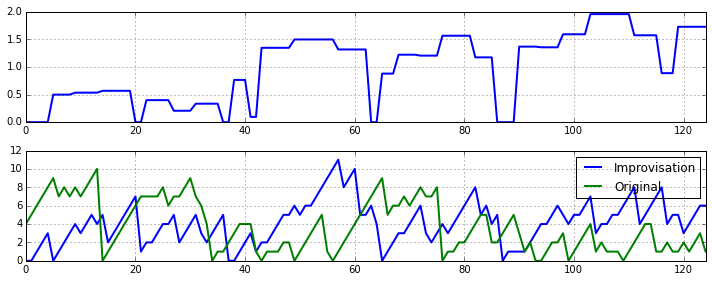

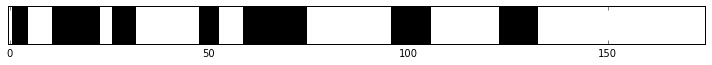

In [11]:
print seq_s
print swi_s
x_s, _w = vge.audio_synthesis(target_file, 'vmo_synthesis_test2.wav', seq_s, 
                            buffer_size = fft_size, hop = hop_size)
plt.figure(figsize = (10,4))
ir_x, h0, h1 = oracle_s.IR()
plt.subplot(2,1,1)
plt.plot(ir_x, linewidth = 2)
plt.grid('on')
plt.xlim(0, oracle_s.n_states-2)

plt.subplot(2,1,2)
plt.plot(oracle_s.lrs, linewidth = 2)
plt.hold('on')
plt.plot(oracle_t.lrs[50:], linewidth = 2)
plt.grid('on')
plt.xlim(0, oracle_s.n_states-2)
plt.legend(['Improvisation','Original'])
plt.tight_layout()

seq_s_plot = np.zeros((1, oracle_t.n_states-1))
seq_s_plot[:,seq_s] = 1

plt.figure(figsize = (10,1))
plt.imshow(seq_s_plot, interpolation = 'nearest', cmap = 'Greys', aspect = 'auto')
plt.yticks([])
plt.tight_layout()

In [12]:
IPython.display.Audio(data=x_s, rate=sr)

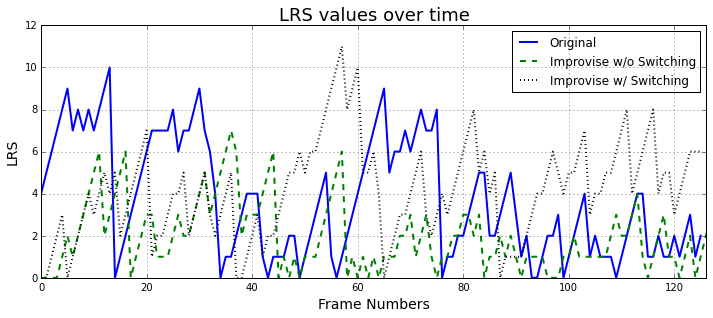

In [13]:
plt.figure(figsize = (10,4.5))
plt.plot(oracle_t.lrs[50:], linewidth = 2)
plt.title('LRS values over time', fontsize = 18)
plt.hold('on')
plt.plot(oracle_x.lrs, '--', linewidth = 2)
plt.plot(oracle_s.lrs, ':k', linewidth = 2)
plt.grid('on')
plt.xlim([0, oracle_x.n_states-2])
plt.legend(['Original','Improvise w/o Switching','Improvise w/ Switching'])
plt.ylabel('LRS', fontsize = 14)
plt.xlabel('Frame Numbers', fontsize =14)
plt.tight_layout()
# plt.savefig('selfimp.pdf')

## Improvisation with the Entire File 

In [ ]:
cont = int(np.floor(oracle_t.avg_lrs[-1]))
seq2 = vge.improvise(oracle_t, oracle_x.n_states-1, k = 1, LRS = LRS, weight = None, continuity = cont)

[1, 2, 3, 4, 5, 6, 7, 103, 104, 105, 106, 107, 108, 109, 110, 114, 115, 116, 117, 118, 119, 120, 121, 105, 106, 107, 108, 109, 110, 111, 112, 123, 104, 105, 106, 107, 108, 109, 110, 111, 12, 13, 14, 15, 16, 17, 18, 19, 111, 112, 113, 114, 115, 116, 117, 118]


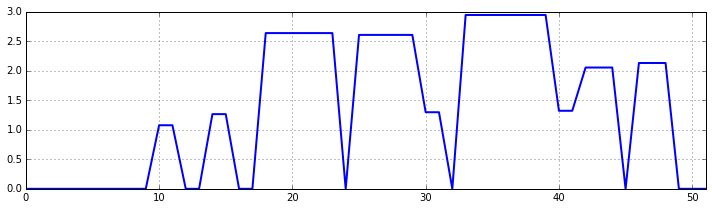

In [11]:
print seq2
x2, _w = vge.audio_synthesis(target_file, 'vmo_synthesis_test2.wav', seq2, 
                            buffer_size = fft_size, hop = hop_size)
C_x2 = librosa.feature.chromagram(y=x2, sr=sr, n_fft=fft_size, hop_length=hop_size, octwidth = None)
feature_x2 = np.log(C_x2+np.finfo(float).eps)
feature_x2 = pre.normalize(feature_x2)
chroma_frames_x2 = feature_x2.transpose()
oracle_x2 = vmo.build_oracle(chroma_frames_x2, flag = 'a', 
                            threshold = ideal_t[0][1], 
                            feature = 'chroma')

plt.figure(figsize = (10,3))
ir_x, h0, h1 = oracle_x2.IR()
plt.plot(ir_x, linewidth = 2)
plt.grid('on')
plt.xlim(0, oracle_x.n_states-2)
plt.tight_layout()

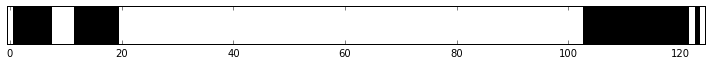

In [12]:
seq2_plot = np.zeros((1, oracle_t.n_states-1))
seq2_plot[:,seq2] = 1

plt.figure(figsize = (10,1))
plt.imshow(seq2_plot, interpolation = 'nearest', cmap = 'Greys', aspect = 'auto')
plt.yticks([])
plt.tight_layout()
IPython.display.Audio(data=x2, rate=sr)

In [10]:
cont = int(np.floor(oracle_t.avg_lrs[-1]))
seq2 = vge.improvise(oracle_t, oracle_x.n_states-1, k = 1, LRS = LRS, weight = None, continuity = cont)